## View example downloaded EMIT agricultural scenes

### Step 1. Setup notebook

Import packages

In [1]:
import os
import warnings
import csv
from osgeo import gdal
import numpy as np
import math
import rasterio as rio
import xarray as xr
import holoviews as hv
import hvplot.xarray
import netCDF4 as nc

# This will ignore some warnings caused by holoviews
warnings.simplefilter('ignore') 

### Step 2. Define image to view from downloaded file list

In [2]:
# Define local storage location on CyVerse - default is HYR-SENSE/data/emit
loc_file_path = '../../data/emit/'

# Downloaded EMIT datasets
os.listdir(loc_file_path)

['EMIT_L2A_RFL_001_20230729T205630_2321014_019.nc',
 'EMIT_L2A_RFL_001_20230729T205642_2321014_020.nc',
 'EMIT_L2A_RFL_001_20240412T210505_2410314_026.nc',
 'EMIT_L2A_RFL_001_20230822T175130_2323412_008.nc']

### Step 3. Opening EMIT Data¶

EMIT L2A Reflectance Data are distributed in a non-orthocorrected spatially raw NetCDF4 (.nc) format consisting of the data and its associated metadata. Inside the L2A Reflectance `.nc` file there are 3 groups. Groups can be thought of as containers to organize the data. 

1. The root group that can be considered the main dataset contains the reflectance data described by the downtrack, crosstrack, and bands dimensions.  
2. The `sensor_band_parameters`  group containing the wavelength center and the full-width half maximum (FWHM) of each band.  
3. The `location` group contains latitude and longitude values at the center of each pixel described by the crosstrack and downtrack dimensions, as well as a geometry lookup table (GLT) described by the ortho_x and ortho_y dimensions. The GLT is an orthorectified image (EPSG:4326) consisting of 2 layers containing downtrack and crosstrack indices. These index positions allow us to quickly project the raw data onto this geographic grid.

To access the `.nc` file we will use the `netCDF4` and `xarray` libraries. The `netCDF4` library will be used to explore thee data structure, then we will use `xarray` to work with the data. `xarray` is a python package for working with labelled multi-dimensional arrays. It provides a data model where data, dimensions, and attributes together in an easily interpretable way. 

In [3]:
# Pick an image to display
img_file = 'EMIT_L2A_RFL_001_20230729T205642_2321014_020.nc'

# Load image to memory
img_file_dat = os.path.join(loc_file_path,img_file)
ds_nc = nc.Dataset(img_file_dat)
ds_nc

<class 'netCDF4._netCDF4.Dataset'>
root group (NETCDF4 data model, file format HDF5):
    ncei_template_version: NCEI_NetCDF_Swath_Template_v2.0
    summary: The Earth Surface Mineral Dust Source Investigation (EMIT) is an Earth Ventures-Instrument (EVI-4) Mission that maps the surface mineralogy of arid dust source regions via imaging spectroscopy in the visible and short-wave infrared (VSWIR). Installed on the International Space Station (ISS), the EMIT instrument is a Dyson imaging spectrometer that uses contiguous spectroscopic measurements from 410 to 2450 nm to resolve absoprtion features of iron oxides, clays, sulfates, carbonates, and other dust-forming minerals. During its one-year mission, EMIT will observe the sunlit Earth's dust source regions that occur within +/-52° latitude and produce maps of the source regions that can be used to improve forecasts of the role of mineral dust in the radiative forcing (warming or cooling) of the atmosphere.\n\nThis file contains L2A esti

In [4]:
ds_nc['location']

<class 'netCDF4._netCDF4.Group'>
group /location:
    dimensions(sizes): 
    variables(dimensions): float64 lon(downtrack, crosstrack), float64 lat(downtrack, crosstrack), float64 elev(downtrack, crosstrack), int32 glt_x(ortho_y, ortho_x), int32 glt_y(ortho_y, ortho_x)
    groups: 

From this output, we can see the `reflectance` variable, and the  `sensor_band_parameters` and `location` groups. We can also see the dimensions, their sizes, and file metadata.

Now that we have a better understanding of the structure of the file, read the EMIT data as an `xarray.Dataset` and preview it.

In [5]:
ds = xr.open_dataset(img_file_dat)
ds

<xarray.Dataset>
Dimensions:      (downtrack: 1280, crosstrack: 1242, bands: 285)
Dimensions without coordinates: downtrack, crosstrack, bands
Data variables:
    reflectance  (downtrack, crosstrack, bands) float32 ...
Attributes: (12/38)
    ncei_template_version:             NCEI_NetCDF_Swath_Template_v2.0
    summary:                           The Earth Surface Mineral Dust Source ...
    keywords:                          Imaging Spectroscopy, minerals, EMIT, ...
    Conventions:                       CF-1.63
    sensor:                            EMIT (Earth Surface Mineral Dust Sourc...
    instrument:                        EMIT
    ...                                ...
    southernmost_latitude:             40.118375954610386
    spatialResolution:                 0.000542232520256367
    spatial_ref:                       GEOGCS["WGS 84",DATUM["WGS_1984",SPHER...
    geotransform:                      [-1.02729481e+02  5.42232520e-04 -0.00...
    day_night_flag:                    Day
    title:                             EMIT L2A Estimated Surface Reflectance...

This `xarray` dataset only contains the `reflectance` variable and attributes metadata, not the data from the other groups in the file. This is because `xarray` only supports reading non-hierarchical (flat) datasets, meaning that when loading a NetCDF into an `xarray.Dataset`, only the root group is added. The other groups will have to be read into `xarray` separately. We can list them using the `netCDF4` library to get the group names, then use that to add them to new `xarray` datasets.

In [6]:
ds_nc.groups.keys()

dict_keys(['sensor_band_parameters', 'location'])

Now that we know the other group names, read the `sensor_band_parameters` and `location` groups into their own `xarray` datasets.

In [7]:
wvl = xr.open_dataset(img_file_dat,group='sensor_band_parameters')
wvl

<xarray.Dataset>
Dimensions:           (bands: 285)
Dimensions without coordinates: bands
Data variables:
    wavelengths       (bands) float32 ...
    fwhm              (bands) float32 ...
    good_wavelengths  (bands) float32 ...

In [8]:
print(wvl.wavelengths)

<xarray.DataArray 'wavelengths' (bands: 285)>
[285 values with dtype=float32]
Dimensions without coordinates: bands
Attributes:
    long_name:  Wavelength Centers
    units:      nm


In [9]:
wvl.wavelengths[:,]

<xarray.DataArray 'wavelengths' (bands: 285)>
[285 values with dtype=float32]
Dimensions without coordinates: bands
Attributes:
    long_name:  Wavelength Centers
    units:      nm

Display the wavelenght centers

In [10]:
wvl.wavelengths.values

array([ 381.00558,  388.4092 ,  395.81583,  403.2254 ,  410.638  ,
        418.0536 ,  425.47214,  432.8927 ,  440.31726,  447.7428 ,
        455.17035,  462.59888,  470.0304 ,  477.46292,  484.89743,
        492.33292,  499.77142,  507.2099 ,  514.6504 ,  522.0909 ,
        529.5333 ,  536.9768 ,  544.42126,  551.8667 ,  559.3142 ,
        566.7616 ,  574.20905,  581.6585 ,  589.108  ,  596.55835,
        604.0098 ,  611.4622 ,  618.9146 ,  626.36804,  633.8215 ,
        641.2759 ,  648.7303 ,  656.1857 ,  663.6411 ,  671.09753,
        678.5539 ,  686.0103 ,  693.4677 ,  700.9251 ,  708.38354,
        715.84094,  723.2993 ,  730.7587 ,  738.2171 ,  745.6765 ,
        753.1359 ,  760.5963 ,  768.0557 ,  775.5161 ,  782.97754,
        790.4379 ,  797.89935,  805.36176,  812.8232 ,  820.2846 ,
        827.746  ,  835.2074 ,  842.66986,  850.1313 ,  857.5937 ,
        865.0551 ,  872.5176 ,  879.98004,  887.44147,  894.90393,
        902.3664 ,  909.82886,  917.2913 ,  924.7538 ,  932.21

In [11]:
loc = xr.open_dataset(img_file_dat,group='location')
loc

<xarray.Dataset>
Dimensions:  (downtrack: 1280, crosstrack: 1242, ortho_y: 1872, ortho_x: 2548)
Dimensions without coordinates: downtrack, crosstrack, ortho_y, ortho_x
Data variables:
    lon      (downtrack, crosstrack) float64 ...
    lat      (downtrack, crosstrack) float64 ...
    elev     (downtrack, crosstrack) float64 ...
    glt_x    (ortho_y, ortho_x) float64 ...
    glt_y    (ortho_y, ortho_x) float64 ...

Show some of the location data, for example a subset of the lat/longs

In [12]:
print(loc.lon[1:5,1:5].values)

[[-102.11637163 -102.11689162 -102.11741121 -102.11793252]
 [-102.11577409 -102.11629498 -102.1168154  -102.11733653]
 [-102.11517861 -102.11570008 -102.11622066 -102.11673964]
 [-102.11458195 -102.11510301 -102.11562356 -102.11614321]]


In [13]:
print(loc.lat[1:5,1:5].values)

[[40.11992624 40.12037547 40.12082524 40.12127048]
 [40.12027636 40.12072337 40.12117113 40.12161683]
 [40.12062141 40.12106702 40.12151439 40.12196532]
 [40.12097054 40.12141716 40.1218646  40.12231386]]


We could merge all 3 datasets, but since `sensor_band_parameters` and `location` describe various aspects of the `reflectance` variable we can simply add them as coordinates, along with a downtrack and crosstrack dimension to describe the reflectance data array. This will allow us to utilize some additional features of `xarray`. 

In [14]:
# Create coordinates and an index for the downtrack and crosstrack dimensions, then unpack the variables from the wvl and loc datasets and set them as coordinates for ds
ds = ds.assign_coords({'downtrack':(['downtrack'], ds.downtrack.data),'crosstrack':(['crosstrack'],ds.crosstrack.data), **wvl.variables, **loc.variables})
ds

<xarray.Dataset>
Dimensions:           (downtrack: 1280, crosstrack: 1242, bands: 285,
                       ortho_y: 1872, ortho_x: 2548)
Coordinates:
  * downtrack         (downtrack) int64 0 1 2 3 4 5 ... 1275 1276 1277 1278 1279
  * crosstrack        (crosstrack) int64 0 1 2 3 4 ... 1237 1238 1239 1240 1241
    wavelengths       (bands) float32 381.0 388.4 395.8 ... 2.486e+03 2.493e+03
    fwhm              (bands) float32 ...
    good_wavelengths  (bands) float32 ...
    lon               (downtrack, crosstrack) float64 ...
    lat               (downtrack, crosstrack) float64 ...
    elev              (downtrack, crosstrack) float64 ...
    glt_x             (ortho_y, ortho_x) float64 ...
    glt_y             (ortho_y, ortho_x) float64 ...
Dimensions without coordinates: bands, ortho_y, ortho_x
Data variables:
    reflectance       (downtrack, crosstrack, bands) float32 ...
Attributes: (12/38)
    ncei_template_version:             NCEI_NetCDF_Swath_Template_v2.0
    summary:                           The Earth Surface Mineral Dust Source ...
    keywords:                          Imaging Spectroscopy, minerals, EMIT, ...
    Conventions:                       CF-1.63
    sensor:                            EMIT (Earth Surface Mineral Dust Sourc...
    instrument:                        EMIT
    ...                                ...
    southernmost_latitude:             40.118375954610386
    spatialResolution:                 0.000542232520256367
    spatial_ref:                       GEOGCS["WGS 84",DATUM["WGS_1984",SPHER...
    geotransform:                      [-1.02729481e+02  5.42232520e-04 -0.00...
    day_night_flag:                    Day
    title:                             EMIT L2A Estimated Surface Reflectance...

Another step we can take is to swap the 'bands' dimension with wavelengths. Doing this will allow us to index based on the wavelength of the band, and remove 'bands' as a dimension. We can do this since bands is just a 3rd dimension that will is defined based on the 'sensor_band_parameters' group (i.e. 'wavelengths' for reflectance, or 'mask_bands' for mask data).

In [15]:
ds = ds.swap_dims({'bands':'wavelengths'})
ds

<xarray.Dataset>
Dimensions:           (downtrack: 1280, crosstrack: 1242, wavelengths: 285,
                       ortho_y: 1872, ortho_x: 2548)
Coordinates:
  * downtrack         (downtrack) int64 0 1 2 3 4 5 ... 1275 1276 1277 1278 1279
  * crosstrack        (crosstrack) int64 0 1 2 3 4 ... 1237 1238 1239 1240 1241
  * wavelengths       (wavelengths) float32 381.0 388.4 ... 2.486e+03 2.493e+03
    fwhm              (wavelengths) float32 ...
    good_wavelengths  (wavelengths) float32 ...
    lon               (downtrack, crosstrack) float64 ...
    lat               (downtrack, crosstrack) float64 ...
    elev              (downtrack, crosstrack) float64 ...
    glt_x             (ortho_y, ortho_x) float64 ...
    glt_y             (ortho_y, ortho_x) float64 ...
Dimensions without coordinates: ortho_y, ortho_x
Data variables:
    reflectance       (downtrack, crosstrack, wavelengths) float32 ...
Attributes: (12/38)
    ncei_template_version:             NCEI_NetCDF_Swath_Template_v2.0
    summary:                           The Earth Surface Mineral Dust Source ...
    keywords:                          Imaging Spectroscopy, minerals, EMIT, ...
    Conventions:                       CF-1.63
    sensor:                            EMIT (Earth Surface Mineral Dust Sourc...
    instrument:                        EMIT
    ...                                ...
    southernmost_latitude:             40.118375954610386
    spatialResolution:                 0.000542232520256367
    spatial_ref:                       GEOGCS["WGS 84",DATUM["WGS_1984",SPHER...
    geotransform:                      [-1.02729481e+02  5.42232520e-04 -0.00...
    day_night_flag:                    Day
    title:                             EMIT L2A Estimated Surface Reflectance...

Now we have an `xarray.Dataset` containing all of the information from EMIT netCDF file. Since these datasets are large, we can go ahead and delete objects we won't be using to conserve memory.

In [16]:
del wvl
del loc

## Step 4. Visualizing Spectra - Non-Orthorectified

Pick a random downtrack and crosstrack location. Here we chose 660, 370 (downtrack,crosstrack). Next use the `sel()` function from `xarray` and the `hvplot.line()` functions to first select the spatial position and then plot a line showing the reflectance at that location. 

In [18]:
example = ds['reflectance'].sel(downtrack=550,crosstrack=300)
example.hvplot.line(y='reflectance',x='wavelengths', color='black', frame_height=400, frame_width=600)

:Curve   [wavelengths]   (reflectance)

We can see some flat regions in the spectral curve around 1320-1440 nm and 1770-1970 nm. These are where water absoption features in these regions were removed. Typically this data is noisy due to the moisture present in the atmosphere; therefore, these spectral regions offer little information about targets and can be excluded from calculations.

We can set reflectance values where the good_wavelenghts is 0 (these will have a reflectance of -0.1) to np.nan do mask them out and improve visualization.

In [19]:
ds['reflectance'].data[:,:,ds['good_wavelengths'].data==0] = np.nan

Plot the filtered reflectance values using the same downtrack and crosstrack position as above.

In [24]:
ds['reflectance'].sel(downtrack=550,crosstrack=300).hvplot.line(y='reflectance',x='wavelengths', color='black', frame_height=400, frame_width=600)

:Curve   [wavelengths]   (reflectance)

Without these data we can better interpret the spectral curve and `hvplot` will do a better job automatically scaling our axes.

## Step 5. Display non-orthorectified image

We can also plot the data spatially. Since we changed our dimension and index to wavelengths we can use the sel() function to spectrally subset to the wavelength nearest to 850nm in the NIR, then plot the data spatially using hvplot.image() to view the reflectance at 850nm of each pixel across the acquired region.

In [25]:
refl850 = ds.sel(wavelengths=850, method='nearest')

In [33]:
refl850.hvplot.image(cmap='viridis', aspect = 'equal', frame_width=720).opts(title=f"{refl850.wavelengths.values:.3f} {refl850.wavelengths.units}")

:Image   [crosstrack,downtrack]   (reflectance)

Using the map above, we can now scroll around with the cursor and zoom in and out to identify fields / points of intersts. For example, we can zoom into the three center-pivot irrigation fields found at 791.757 crosstrack and 759.445 downtrack location


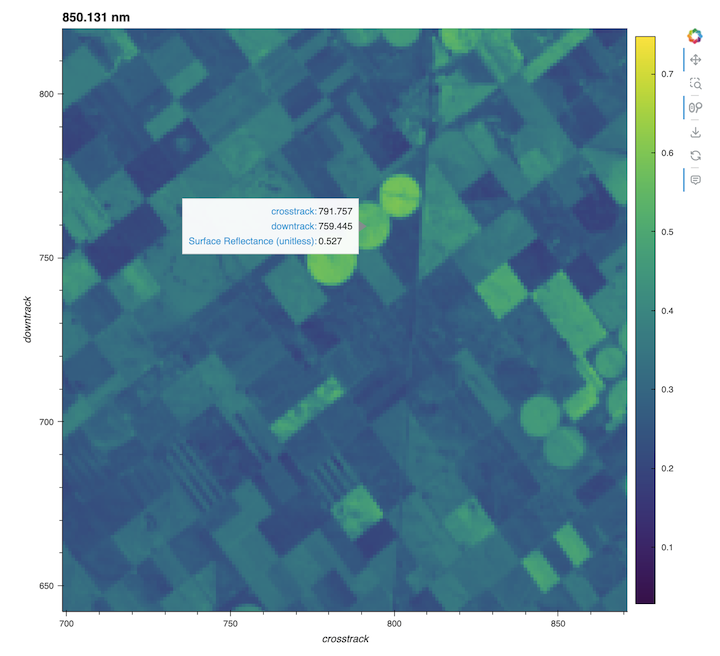

Since we zoomed into this field, lets plot the spectra from that pixel. We can use the "nearest" method to select the nearest whole value pixel

In [32]:
ds['reflectance'].sel(downtrack=759.445,crosstrack=791.757,method="nearest").hvplot.line(y='reflectance',x='wavelengths', color='black', frame_height=400, frame_width=600)

:Curve   [wavelengths]   (reflectance)

Note that we can then highlight the same band on the spectra plot for that pixel and compare the reflectance value shown in the map above with from the curve for the same 850.131 nm band.  Both show the same reflectance value between 0-1 of 0.527 or 52.7% reflectance

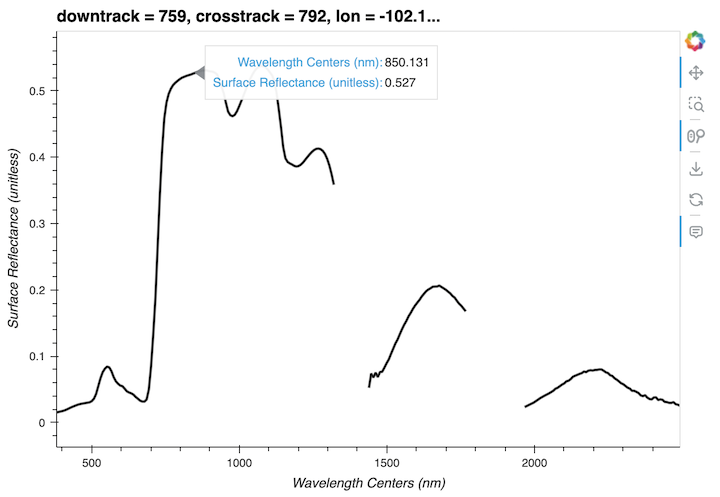

We can also create an NDVI image

In [35]:
refl850 = ds.sel(wavelengths=850, method='nearest')
refl655 = ds.sel(wavelengths=655, method='nearest')
ndvi = (refl850-refl655)/(refl850+refl655)

In [37]:
ndvi

<xarray.Dataset>
Dimensions:           (downtrack: 1280, crosstrack: 1242, ortho_y: 1872,
                       ortho_x: 2548)
Coordinates:
  * downtrack         (downtrack) int64 0 1 2 3 4 5 ... 1275 1276 1277 1278 1279
  * crosstrack        (crosstrack) int64 0 1 2 3 4 ... 1237 1238 1239 1240 1241
    good_wavelengths  float32 1.0
    lon               (downtrack, crosstrack) float64 -102.1 -102.1 ... -102.0
    lat               (downtrack, crosstrack) float64 40.12 40.12 ... 41.13
    elev              (downtrack, crosstrack) float64 1.07e+03 ... 1.073e+03
    glt_x             (ortho_y, ortho_x) float64 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0
    glt_y             (ortho_y, ortho_x) float64 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0
Dimensions without coordinates: ortho_y, ortho_x
Data variables:
    reflectance       (downtrack, crosstrack) float32 0.4691 0.4657 ... 0.5282

In [40]:
ndvi.hvplot.image(cmap='viridis', aspect = 'equal', frame_width=720).opts(title="NDVI Image")

:Image   [crosstrack,downtrack]   (reflectance)

MORE HERE

In [ ]:
# extremely simple example based on - to be improved
# https://github.com/nasa/EMIT-Data-Resources/blob/main/python/tutorials/Exploring_EMIT_L2A_Reflectance.ipynb

In [2]:
import os
import warnings
import csv
from osgeo import gdal
import numpy as np
import math
import rasterio as rio
import xarray as xr
import holoviews as hv
import hvplot.xarray
import netCDF4 as nc

# This will ignore some warnings caused by holoviews
warnings.simplefilter('ignore') 

In [3]:
file = 'EMIT_L2A_RFL_001_20230822T175130_2323412_008.nc'
fp = os.path.join('../../data/emit/',file)
ds_nc = nc.Dataset(fp)
ds_nc

<class 'netCDF4._netCDF4.Dataset'>
root group (NETCDF4 data model, file format HDF5):
    ncei_template_version: NCEI_NetCDF_Swath_Template_v2.0
    summary: The Earth Surface Mineral Dust Source Investigation (EMIT) is an Earth Ventures-Instrument (EVI-4) Mission that maps the surface mineralogy of arid dust source regions via imaging spectroscopy in the visible and short-wave infrared (VSWIR). Installed on the International Space Station (ISS), the EMIT instrument is a Dyson imaging spectrometer that uses contiguous spectroscopic measurements from 410 to 2450 nm to resolve absoprtion features of iron oxides, clays, sulfates, carbonates, and other dust-forming minerals. During its one-year mission, EMIT will observe the sunlit Earth's dust source regions that occur within +/-52° latitude and produce maps of the source regions that can be used to improve forecasts of the role of mineral dust in the radiative forcing (warming or cooling) of the atmosphere.\n\nThis file contains L2A esti

In [4]:
ds_nc['location']

<class 'netCDF4._netCDF4.Group'>
group /location:
    dimensions(sizes): 
    variables(dimensions): float64 lon(downtrack, crosstrack), float64 lat(downtrack, crosstrack), float64 elev(downtrack, crosstrack), int32 glt_x(ortho_y, ortho_x), int32 glt_y(ortho_y, ortho_x)
    groups: 

In [5]:
ds = xr.open_dataset(fp)
ds

<xarray.Dataset>
Dimensions:      (downtrack: 1280, crosstrack: 1242, bands: 285)
Dimensions without coordinates: downtrack, crosstrack, bands
Data variables:
    reflectance  (downtrack, crosstrack, bands) float32 ...
Attributes: (12/38)
    ncei_template_version:             NCEI_NetCDF_Swath_Template_v2.0
    summary:                           The Earth Surface Mineral Dust Source ...
    keywords:                          Imaging Spectroscopy, minerals, EMIT, ...
    Conventions:                       CF-1.63
    sensor:                            EMIT (Earth Surface Mineral Dust Sourc...
    instrument:                        EMIT
    ...                                ...
    southernmost_latitude:             39.91720768959534
    spatialResolution:                 0.000542232520256367
    spatial_ref:                       GEOGCS["WGS 84",DATUM["WGS_1984",SPHER...
    geotransform:                      [-1.02584162e+02  5.42232520e-04 -0.00...
    day_night_flag:                    Day
    title:                             EMIT L2A Estimated Surface Reflectance...

In [6]:
ds_nc.groups.keys()

dict_keys(['sensor_band_parameters', 'location'])

In [7]:
wvl = xr.open_dataset(fp,group='sensor_band_parameters')
wvl

<xarray.Dataset>
Dimensions:           (bands: 285)
Dimensions without coordinates: bands
Data variables:
    wavelengths       (bands) float32 ...
    fwhm              (bands) float32 ...
    good_wavelengths  (bands) float32 ...

In [8]:
loc = xr.open_dataset(fp,group='location')
loc

<xarray.Dataset>
Dimensions:  (downtrack: 1280, crosstrack: 1242, ortho_y: 1988, ortho_x: 2356)
Dimensions without coordinates: downtrack, crosstrack, ortho_y, ortho_x
Data variables:
    lon      (downtrack, crosstrack) float64 ...
    lat      (downtrack, crosstrack) float64 ...
    elev     (downtrack, crosstrack) float64 ...
    glt_x    (ortho_y, ortho_x) float64 ...
    glt_y    (ortho_y, ortho_x) float64 ...

In [9]:
# Create coordinates and an index for the downtrack and crosstrack dimensions, then unpack the variables from the wvl and loc datasets and set them as coordinates for ds
ds = ds.assign_coords({'downtrack':(['downtrack'], ds.downtrack.data),'crosstrack':(['crosstrack'],ds.crosstrack.data), **wvl.variables, **loc.variables})
ds

<xarray.Dataset>
Dimensions:           (downtrack: 1280, crosstrack: 1242, bands: 285,
                       ortho_y: 1988, ortho_x: 2356)
Coordinates:
  * downtrack         (downtrack) int64 0 1 2 3 4 5 ... 1275 1276 1277 1278 1279
  * crosstrack        (crosstrack) int64 0 1 2 3 4 ... 1237 1238 1239 1240 1241
    wavelengths       (bands) float32 ...
    fwhm              (bands) float32 ...
    good_wavelengths  (bands) float32 ...
    lon               (downtrack, crosstrack) float64 ...
    lat               (downtrack, crosstrack) float64 ...
    elev              (downtrack, crosstrack) float64 ...
    glt_x             (ortho_y, ortho_x) float64 ...
    glt_y             (ortho_y, ortho_x) float64 ...
Dimensions without coordinates: bands, ortho_y, ortho_x
Data variables:
    reflectance       (downtrack, crosstrack, bands) float32 ...
Attributes: (12/38)
    ncei_template_version:             NCEI_NetCDF_Swath_Template_v2.0
    summary:                           The Earth Surface Mineral Dust Source ...
    keywords:                          Imaging Spectroscopy, minerals, EMIT, ...
    Conventions:                       CF-1.63
    sensor:                            EMIT (Earth Surface Mineral Dust Sourc...
    instrument:                        EMIT
    ...                                ...
    southernmost_latitude:             39.91720768959534
    spatialResolution:                 0.000542232520256367
    spatial_ref:                       GEOGCS["WGS 84",DATUM["WGS_1984",SPHER...
    geotransform:                      [-1.02584162e+02  5.42232520e-04 -0.00...
    day_night_flag:                    Day
    title:                             EMIT L2A Estimated Surface Reflectance...

In [10]:
ds = ds.swap_dims({'bands':'wavelengths'})
ds

<xarray.Dataset>
Dimensions:           (downtrack: 1280, crosstrack: 1242, wavelengths: 285,
                       ortho_y: 1988, ortho_x: 2356)
Coordinates:
  * downtrack         (downtrack) int64 0 1 2 3 4 5 ... 1275 1276 1277 1278 1279
  * crosstrack        (crosstrack) int64 0 1 2 3 4 ... 1237 1238 1239 1240 1241
  * wavelengths       (wavelengths) float32 381.0 388.4 ... 2.486e+03 2.493e+03
    fwhm              (wavelengths) float32 ...
    good_wavelengths  (wavelengths) float32 ...
    lon               (downtrack, crosstrack) float64 ...
    lat               (downtrack, crosstrack) float64 ...
    elev              (downtrack, crosstrack) float64 ...
    glt_x             (ortho_y, ortho_x) float64 ...
    glt_y             (ortho_y, ortho_x) float64 ...
Dimensions without coordinates: ortho_y, ortho_x
Data variables:
    reflectance       (downtrack, crosstrack, wavelengths) float32 ...
Attributes: (12/38)
    ncei_template_version:             NCEI_NetCDF_Swath_Template_v2.0
    summary:                           The Earth Surface Mineral Dust Source ...
    keywords:                          Imaging Spectroscopy, minerals, EMIT, ...
    Conventions:                       CF-1.63
    sensor:                            EMIT (Earth Surface Mineral Dust Sourc...
    instrument:                        EMIT
    ...                                ...
    southernmost_latitude:             39.91720768959534
    spatialResolution:                 0.000542232520256367
    spatial_ref:                       GEOGCS["WGS 84",DATUM["WGS_1984",SPHER...
    geotransform:                      [-1.02584162e+02  5.42232520e-04 -0.00...
    day_night_flag:                    Day
    title:                             EMIT L2A Estimated Surface Reflectance...

In [11]:
del wvl
del loc

In [12]:
example = ds['reflectance'].sel(downtrack=660,crosstrack=370)
example.hvplot.line(y='reflectance',x='wavelengths', color='black', frame_height=400, frame_width=600)

:Curve   [wavelengths]   (reflectance)

In [13]:
ds['reflectance'].data[:,:,ds['good_wavelengths'].data==0] = np.nan

In [15]:
ds['reflectance'].sel(downtrack=660,crosstrack=370).hvplot.line(y='reflectance',x='wavelengths', color='black', frame_height=400, frame_width=600)

:Curve   [wavelengths]   (reflectance)

In [16]:
refl850 = ds.sel(wavelengths=850, method='nearest')

In [17]:
refl850.hvplot.image(cmap='viridis', aspect = 'equal', frame_width=720).opts(title=f"{refl850.wavelengths.values:.3f} {refl850.wavelengths.units}")

:Image   [crosstrack,downtrack]   (reflectance)